In [1]:
from glob import glob
from typing import List, Tuple, Optional, Callable, Mapping, Any
from tqdm.notebook import tqdm

import numpy as np
import cv2
import skfuzzy as fuzz

from sklearn.cluster import KMeans, DBSCAN, OPTICS, SpectralClustering
from sklearn.metrics import pairwise_distances
from matplotlib import pyplot as plt 

%matplotlib inline

In /home/vsydorskyi/anaconda3/envs/venv/lib/python3.7/site-packages/matplotlib/mpl-data/stylelib/_classic_test.mplstyle: 
The text.latex.preview rcparam was deprecated in Matplotlib 3.3 and will be removed two minor releases later.
In /home/vsydorskyi/anaconda3/envs/venv/lib/python3.7/site-packages/matplotlib/mpl-data/stylelib/_classic_test.mplstyle: 
The mathtext.fallback_to_cm rcparam was deprecated in Matplotlib 3.3 and will be removed two minor releases later.
In /home/vsydorskyi/anaconda3/envs/venv/lib/python3.7/site-packages/matplotlib/mpl-data/stylelib/_classic_test.mplstyle: Support for setting the 'mathtext.fallback_to_cm' rcParam is deprecated since 3.3 and will be removed two minor releases later; use 'mathtext.fallback : 'cm' instead.
In /home/vsydorskyi/anaconda3/envs/venv/lib/python3.7/site-packages/matplotlib/mpl-data/stylelib/_classic_test.mplstyle: 
The validate_bool_maybe_none function was deprecated in Matplotlib 3.3 and will be removed two minor releases later.
In /

## Read Data

In [2]:
def read_one_image(
    image_name: str,
    resize_shape: Optional[Tuple[int, int]] = None
):
    image = cv2.imread(image_name)
    image = cv2.cvtColor(image, cv2.COLOR_RGB2BGR)
    if resize_shape is not None:
        image = cv2.resize(image, resize_shape)
    return image

def read_images(
    image_names: List[str],
    resize_shape: Optional[Tuple[int, int]] = None
):
    images = [read_one_image(el, resize_shape) for el in image_names]
    if resize_shape is not None:
        images = np.stack(images)
    return images

['data/4_фрукты.jpg', 'data/6_kosmos.jpg', 'data/2_животные (2).jpg', 'data/1_машина.jpg', 'data/7_схема2.jpg', 'data/3_бактерии.jpg', 'data/1_машина2.jpg', 'data/5_попугай2.jpg', 'data/4_фрукты (2).jpg', 'data/7_схема.jpg', 'data/6_космос.jpg', 'data/8_крыши 2.jpg', 'data/2_животные.jpg', 'data/8_крыши.jpg', 'data/5_попугай.jpg', 'data/3_бактерии2.jpg']


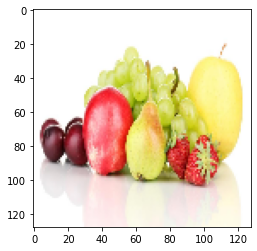

In [3]:
filenames = glob('data/*.jpg')
print(filenames)

all_images = read_images(filenames, (128,128))
plt.imshow(all_images[0]);

## Util functions

In [4]:
def uniform_normalize(im: np.array):
    return im.astype(float) / 255.0

def add_coord_encoding(im: np.array):
    x_encode = np.linspace(0,1,im.shape[0])
    x_encode = x_encode[:,None,None]
    x_encode = np.repeat(x_encode, im.shape[1], axis=1)
    
    y_encode = np.linspace(0,1,im.shape[1])
    y_encode = y_encode[None,:,None]
    y_encode = np.repeat(y_encode, im.shape[0], axis=0)
        
    return np.concatenate([im, x_encode, y_encode], axis=-1)

def apply_cluster_function(
    im: np.array,
    clust_f: Callable,
    use_coord_enc: bool = False
):
    im = uniform_normalize(im)
    if use_coord_enc:
        im = add_coord_encoding(im)
    mask = clust_f(im)
    return mask

def hi_beni_criteria(
    im: np.array,
    mask: np.array,
    
):
    nominator = 0.0
    denominator = 0.0
    im = uniform_normalize(im)
    clusters = np.unique(mask)
    
    im = im.reshape(-1,im.shape[-1])
    mask = mask.flatten()
    for clust in tqdm(clusters):
        clust_elems = im[mask == clust]
        non_clust_elems = im[mask != clust]
        nominator += pairwise_distances(clust_elems, n_jobs=-1).sum()
        denominator += pairwise_distances(clust_elems, non_clust_elems, n_jobs=-1).sum()
    return nominator / denominator

def fuzzy_kmeans(
    im: np.array, 
    params: Mapping[str, Any]
):
    return_classes = params.pop('return_classes')
    
    initial_shape = (im.shape[0], im.shape[1]) 
    im = im.reshape(-1,im.shape[-1]).T
    fuzz_clusters = fuzz.cmeans(
        data=im,
        **params
    )[1]
    fuzz_clusters = fuzz_clusters.T.reshape(initial_shape[0], initial_shape[1], params['c'])
    
    if return_classes:
        fuzz_clusters = fuzz_clusters.argmax(-1)
        
    return fuzz_clusters

def cv2_kmeans(
    im: np.array,
    params: Mapping[str, Any] 
):
    initial_shape = (im.shape[0], im.shape[1])
    im = im.reshape(-1,im.shape[-1])
    
    # Define criteria = ( type, max_iter = 10 , epsilon = 1.0 )
    criteria = (
        cv2.TERM_CRITERIA_EPS + cv2.TERM_CRITERIA_MAX_ITER, 
        params['max_iter'], 
        params['epsilon']
    )
    # Set flags (Just to avoid line break in the code)
    flags = cv2.KMEANS_RANDOM_CENTERS
    # Apply KMeans
    _,labels,_ = cv2.kmeans(
        im.astype(np.float32),
        params['n_clusters'],None,criteria,params['n_attempts'],flags
    )
    
    labels = labels[:,0].reshape(*initial_shape)
    return labels

def sklearn_algs(
    im: np.array,
    algorithm: object,
    params: Mapping[str, Any]
):
    initial_shape = (im.shape[0], im.shape[1])
    im = im.reshape(-1,im.shape[-1])
    clusters = algorithm(**params).fit_predict(im)
    clusters = clusters.reshape(*initial_shape)
    return clusters

def cluster_evaluate_all_images(
    ims: np.array,
    clust_f: Callable,
    use_coord_enc: bool = False
):
    for i in tqdm(range(ims.shape[0])):
        im = ims[i]
        
        plt.title("Image")
        plt.imshow(im)
        plt.show()
        
        mask = apply_cluster_function(
                    im=im,
                    clust_f=clust_f,
                    use_coord_enc=use_coord_enc
                )
        
        for clust in np.unique(mask):
            plt.title(f"Cluster {clust}")
            plt.imshow(im * (mask[:,:,None] == clust))
            plt.show()
            
        hi_beni_score = hi_beni_criteria(im, mask)
        print(f"Hi-Beni criteria: {hi_beni_score}")

## sklearn KMeans

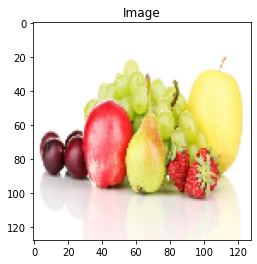

/home/vsydorskyi/anaconda3/envs/venv/lib/python3.7/site-packages/sklearn/cluster/_kmeans.py:974: FutureWarning: 'n_jobs' was deprecated in version 0.23 and will be removed in 0.25.
  " removed in 0.25.", FutureWarning)


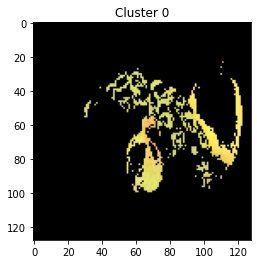

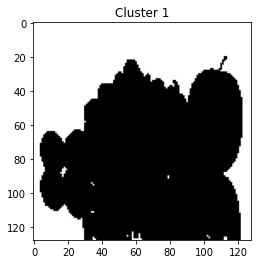

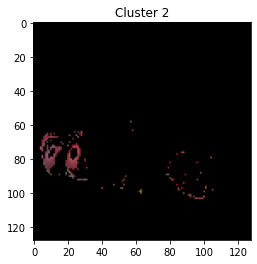

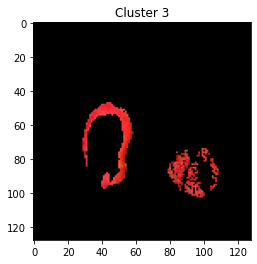

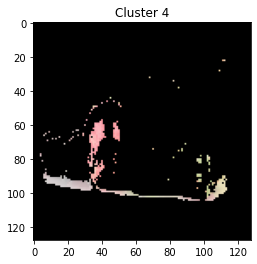

...

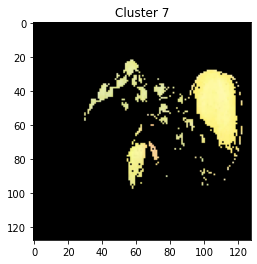

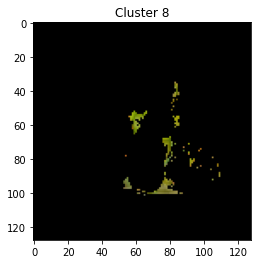

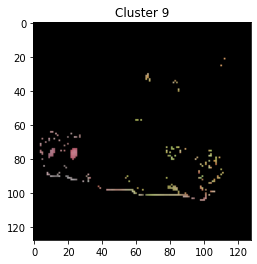

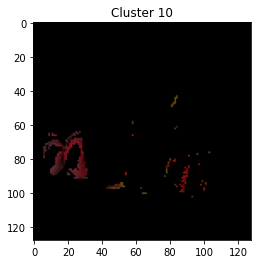

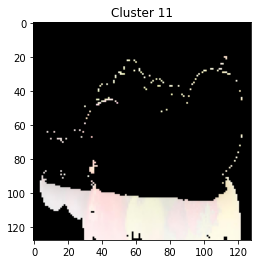


Hi-Beni criteria: 0.014140233726795619


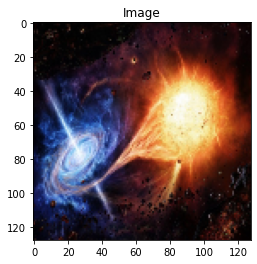

/home/vsydorskyi/anaconda3/envs/venv/lib/python3.7/site-packages/sklearn/cluster/_kmeans.py:974: FutureWarning: 'n_jobs' was deprecated in version 0.23 and will be removed in 0.25.
  " removed in 0.25.", FutureWarning)


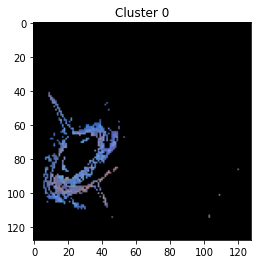

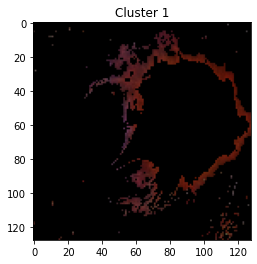

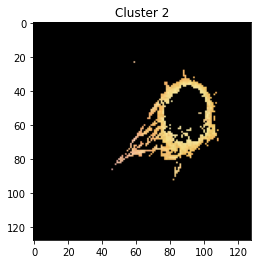

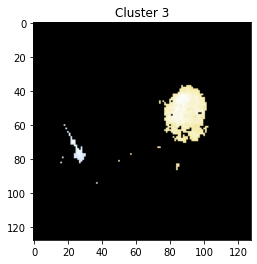

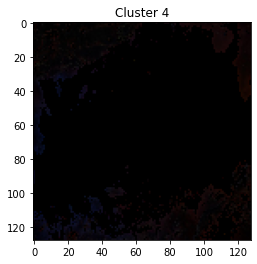

...

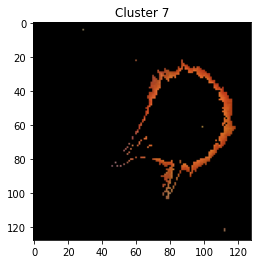

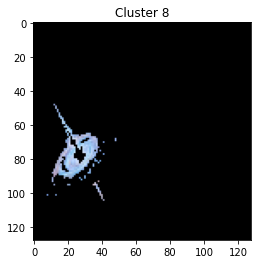

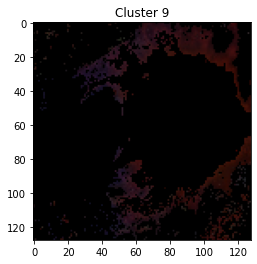

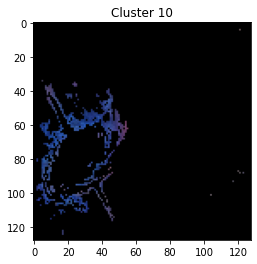

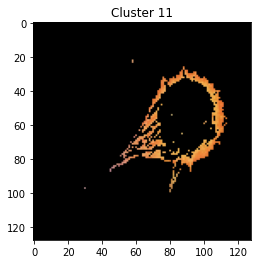


Hi-Beni criteria: 0.020872410862797067


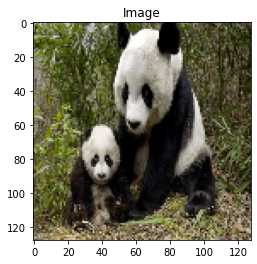

/home/vsydorskyi/anaconda3/envs/venv/lib/python3.7/site-packages/sklearn/cluster/_kmeans.py:974: FutureWarning: 'n_jobs' was deprecated in version 0.23 and will be removed in 0.25.
  " removed in 0.25.", FutureWarning)


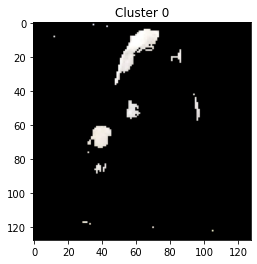

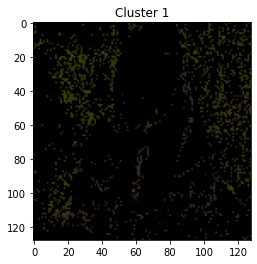

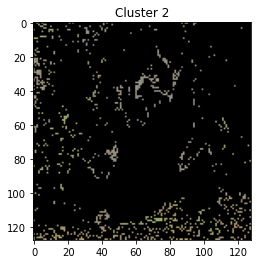

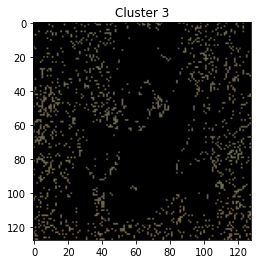

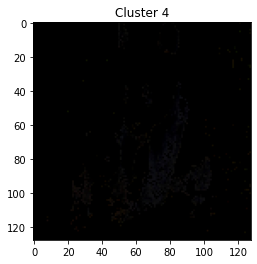

...

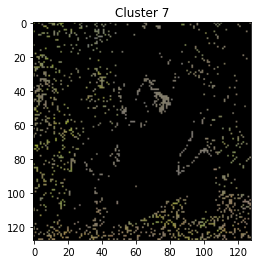

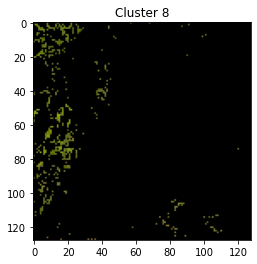

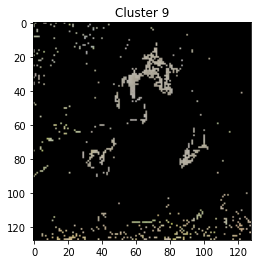

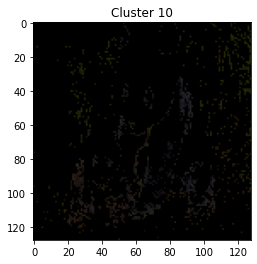

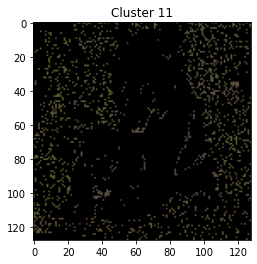


Hi-Beni criteria: 0.016131710133294848


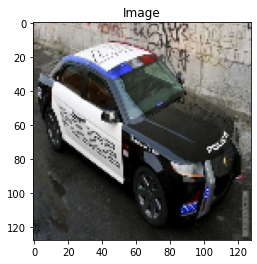

/home/vsydorskyi/anaconda3/envs/venv/lib/python3.7/site-packages/sklearn/cluster/_kmeans.py:974: FutureWarning: 'n_jobs' was deprecated in version 0.23 and will be removed in 0.25.
  " removed in 0.25.", FutureWarning)


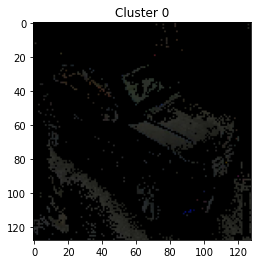

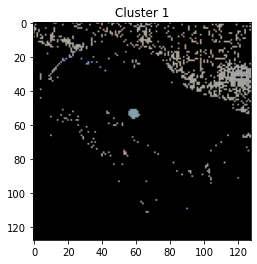

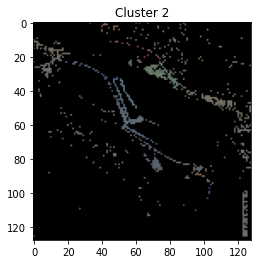

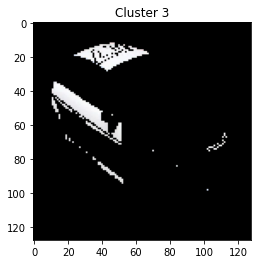

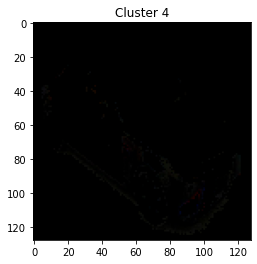

...

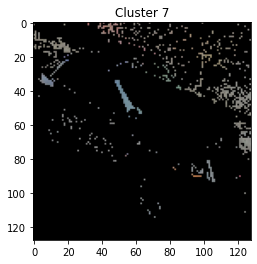

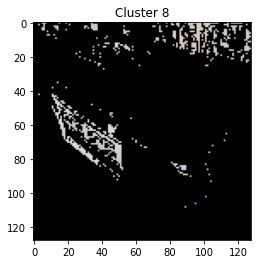

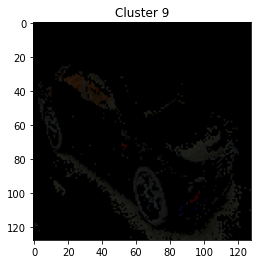

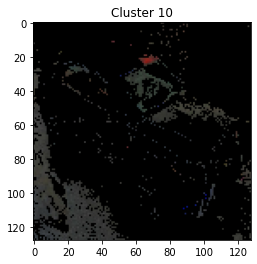

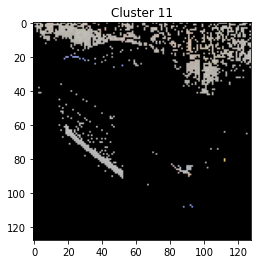


Hi-Beni criteria: 0.011692282639043037


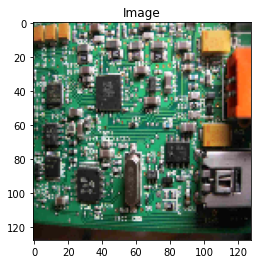

/home/vsydorskyi/anaconda3/envs/venv/lib/python3.7/site-packages/sklearn/cluster/_kmeans.py:974: FutureWarning: 'n_jobs' was deprecated in version 0.23 and will be removed in 0.25.
  " removed in 0.25.", FutureWarning)


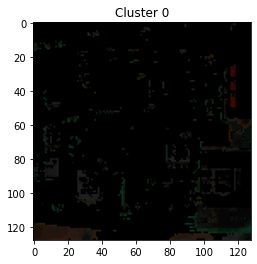

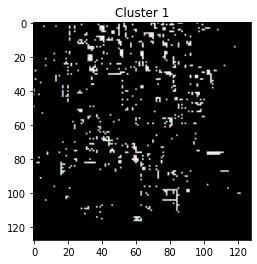

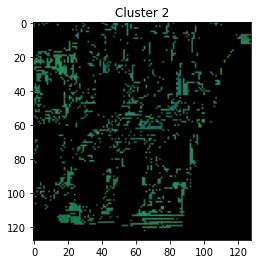

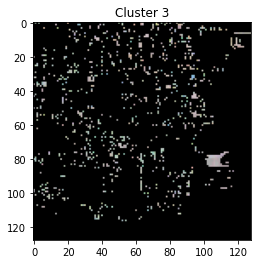

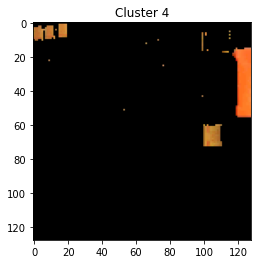

...

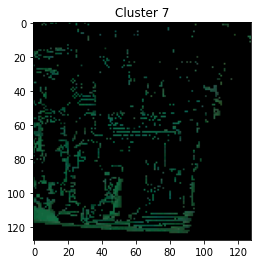

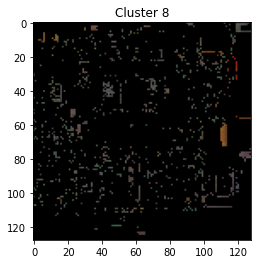

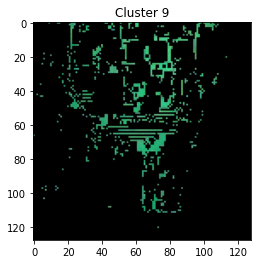

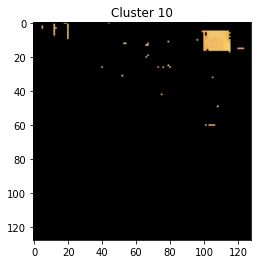

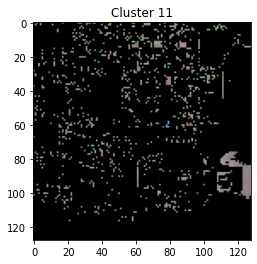


Hi-Beni criteria: 0.023591643784099132


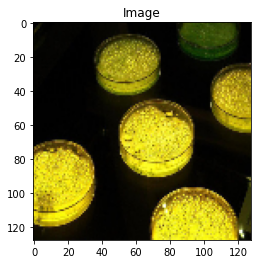

/home/vsydorskyi/anaconda3/envs/venv/lib/python3.7/site-packages/sklearn/cluster/_kmeans.py:974: FutureWarning: 'n_jobs' was deprecated in version 0.23 and will be removed in 0.25.
  " removed in 0.25.", FutureWarning)


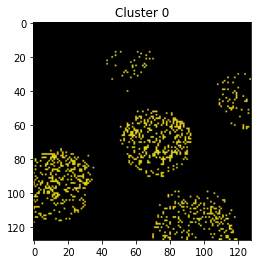

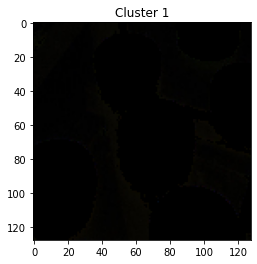

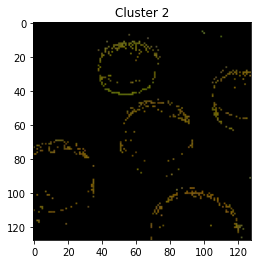

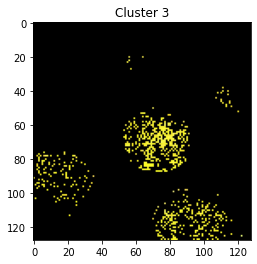

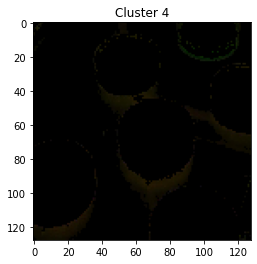

...

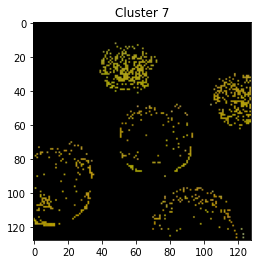

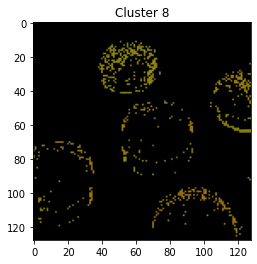

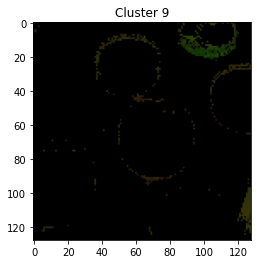

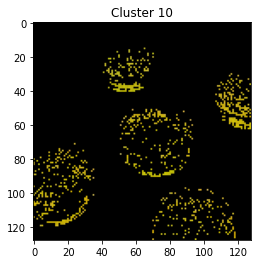

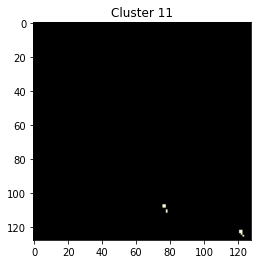


Hi-Beni criteria: 0.011527612546967103


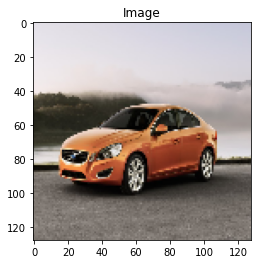

/home/vsydorskyi/anaconda3/envs/venv/lib/python3.7/site-packages/sklearn/cluster/_kmeans.py:974: FutureWarning: 'n_jobs' was deprecated in version 0.23 and will be removed in 0.25.
  " removed in 0.25.", FutureWarning)


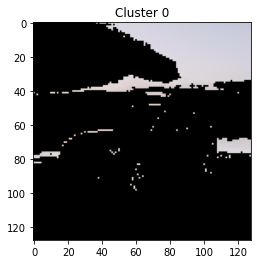

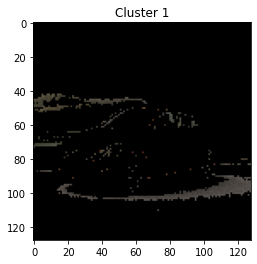

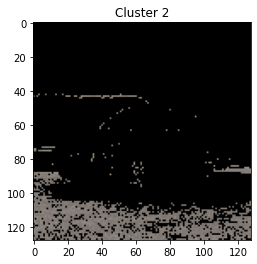

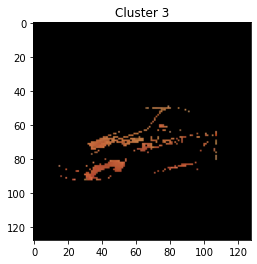

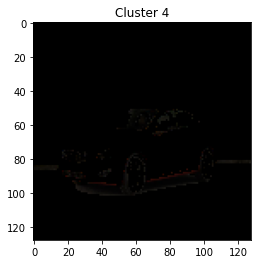

...

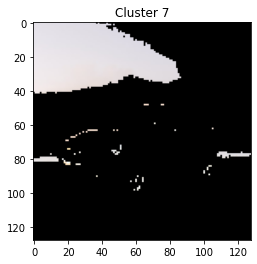

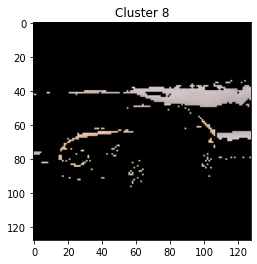

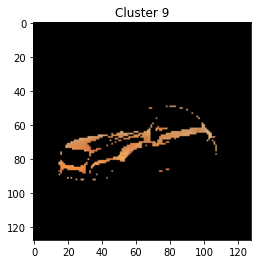

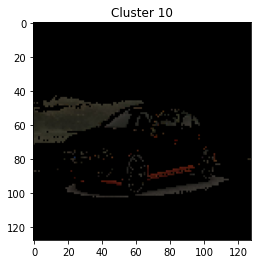

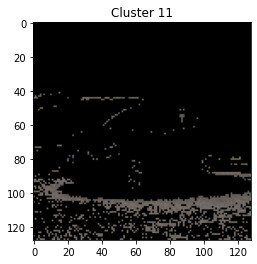


Hi-Beni criteria: 0.01122964857232509


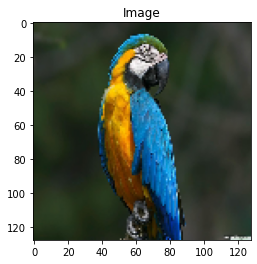

/home/vsydorskyi/anaconda3/envs/venv/lib/python3.7/site-packages/sklearn/cluster/_kmeans.py:974: FutureWarning: 'n_jobs' was deprecated in version 0.23 and will be removed in 0.25.
  " removed in 0.25.", FutureWarning)


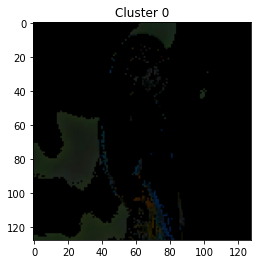

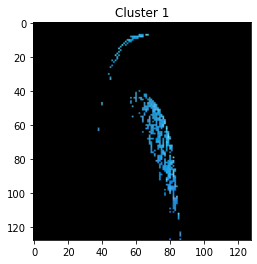

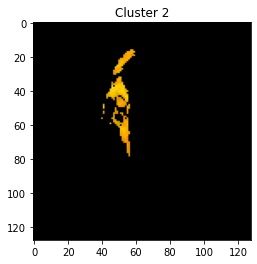

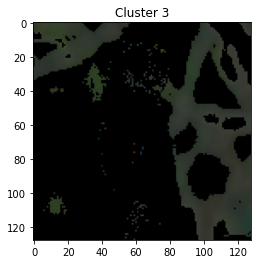

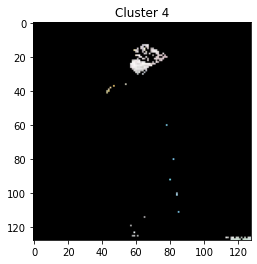

...

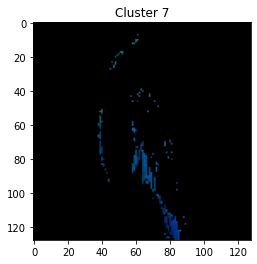

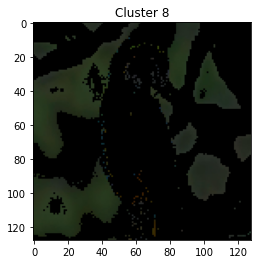

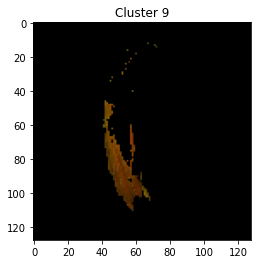

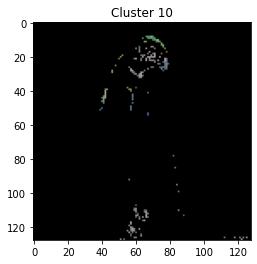

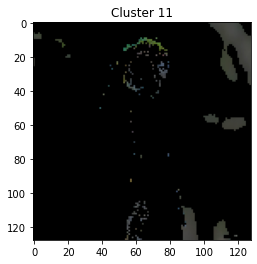


Hi-Beni criteria: 0.03781446064165363


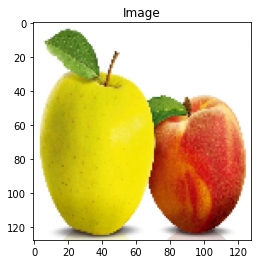

/home/vsydorskyi/anaconda3/envs/venv/lib/python3.7/site-packages/sklearn/cluster/_kmeans.py:974: FutureWarning: 'n_jobs' was deprecated in version 0.23 and will be removed in 0.25.
  " removed in 0.25.", FutureWarning)


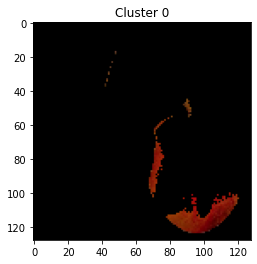

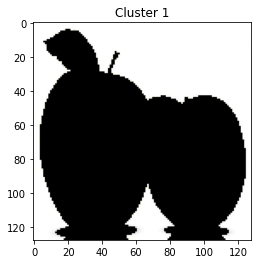

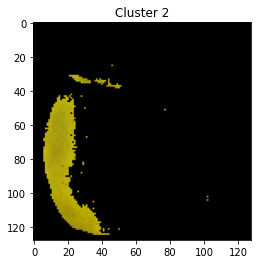

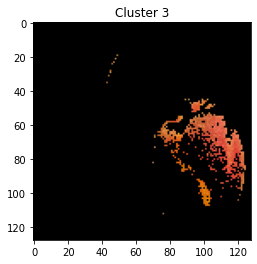

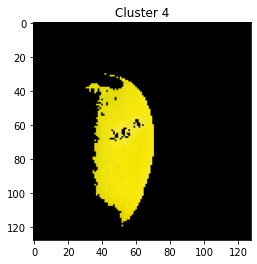

...

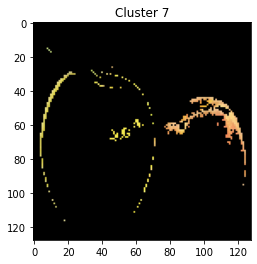

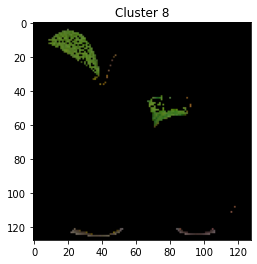

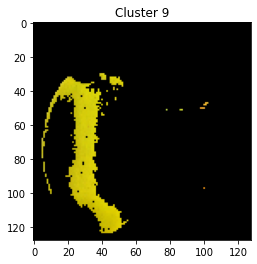

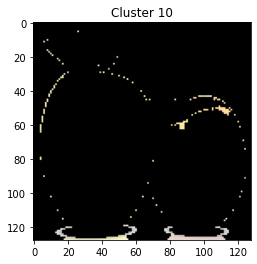

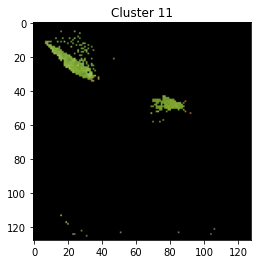


Hi-Beni criteria: 0.009213590609336417


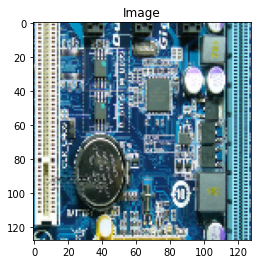

/home/vsydorskyi/anaconda3/envs/venv/lib/python3.7/site-packages/sklearn/cluster/_kmeans.py:974: FutureWarning: 'n_jobs' was deprecated in version 0.23 and will be removed in 0.25.
  " removed in 0.25.", FutureWarning)


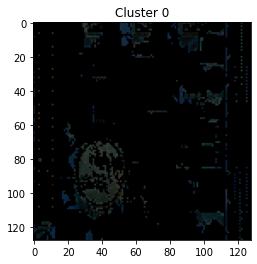

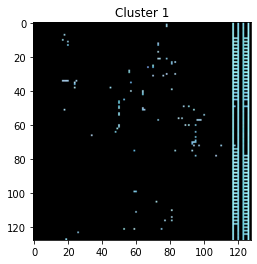

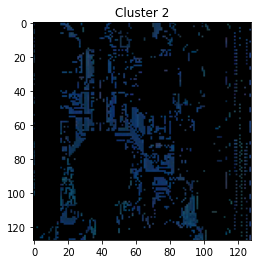

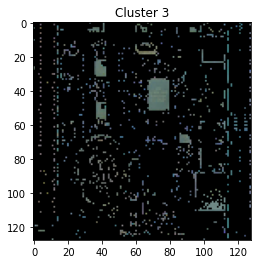

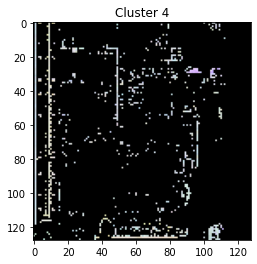

...

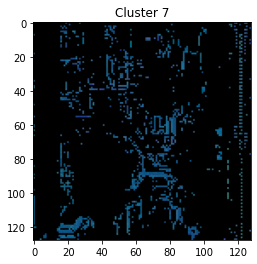

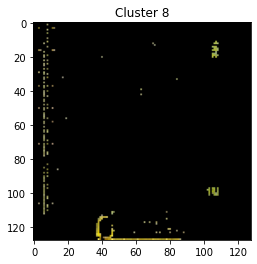

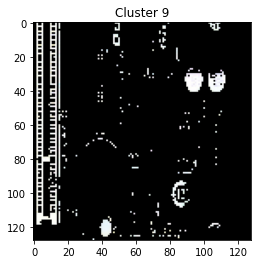

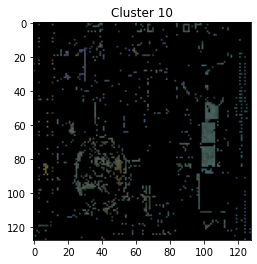

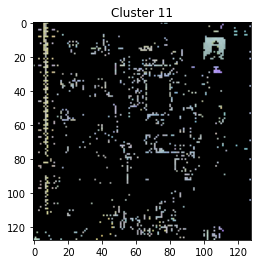


Hi-Beni criteria: 0.021275316747784365


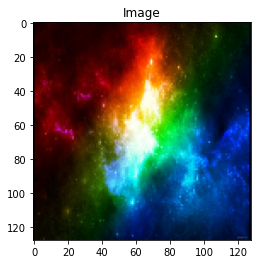

/home/vsydorskyi/anaconda3/envs/venv/lib/python3.7/site-packages/sklearn/cluster/_kmeans.py:974: FutureWarning: 'n_jobs' was deprecated in version 0.23 and will be removed in 0.25.
  " removed in 0.25.", FutureWarning)


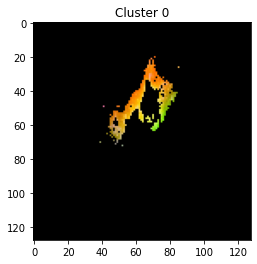

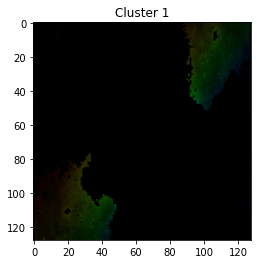

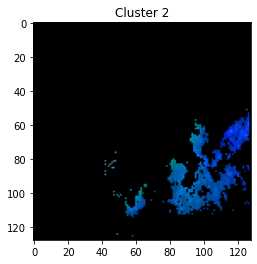

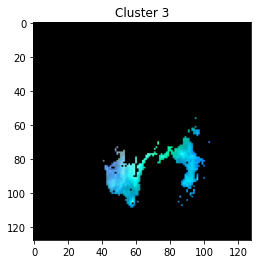

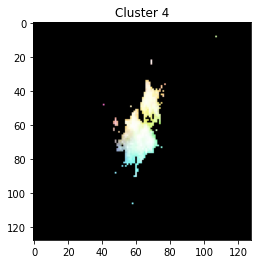

...

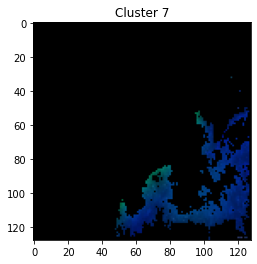

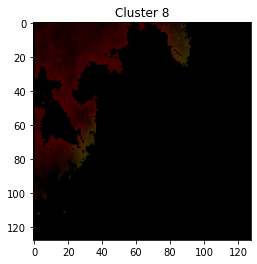

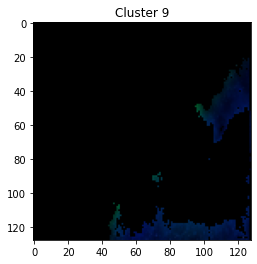

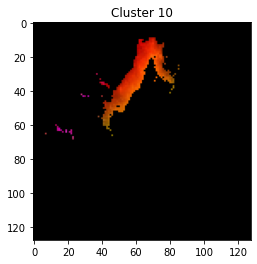

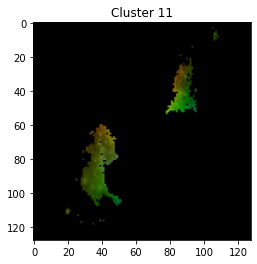


Hi-Beni criteria: 0.025119962011876374


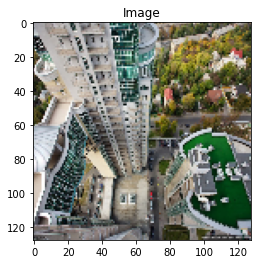

/home/vsydorskyi/anaconda3/envs/venv/lib/python3.7/site-packages/sklearn/cluster/_kmeans.py:974: FutureWarning: 'n_jobs' was deprecated in version 0.23 and will be removed in 0.25.
  " removed in 0.25.", FutureWarning)


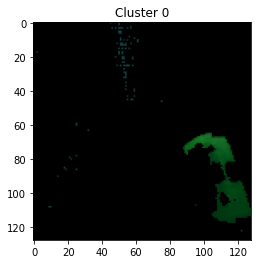

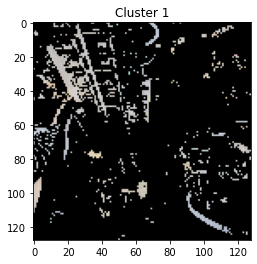

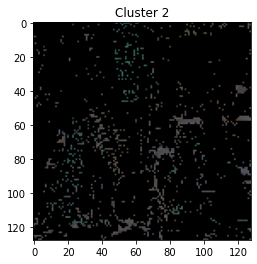

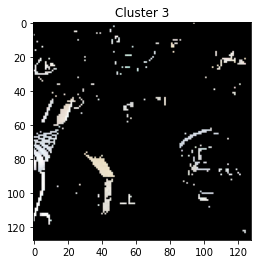

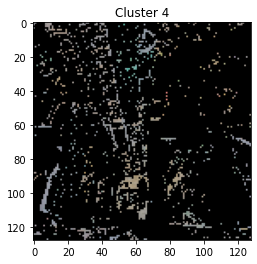

...

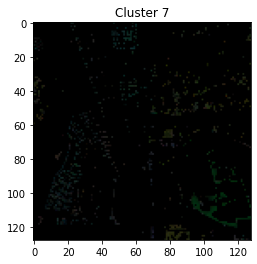

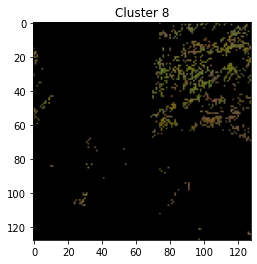

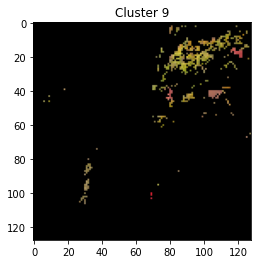

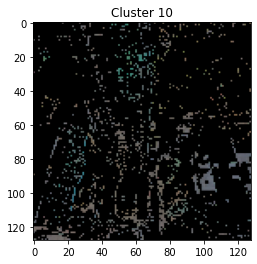

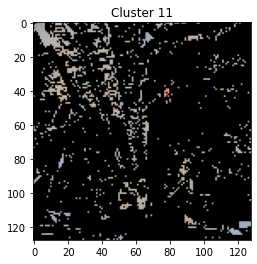


Hi-Beni criteria: 0.019161465761310753


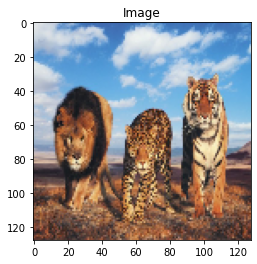

/home/vsydorskyi/anaconda3/envs/venv/lib/python3.7/site-packages/sklearn/cluster/_kmeans.py:974: FutureWarning: 'n_jobs' was deprecated in version 0.23 and will be removed in 0.25.
  " removed in 0.25.", FutureWarning)


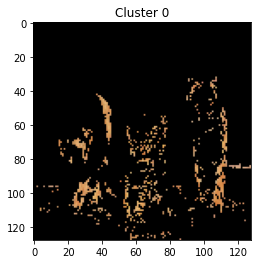

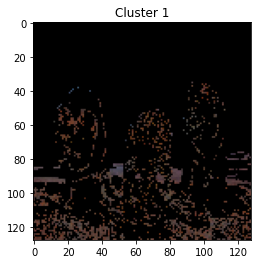

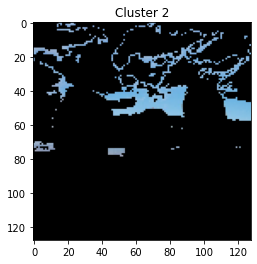

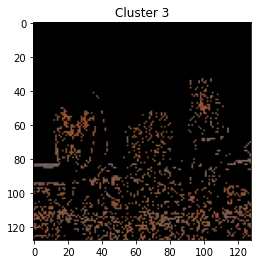

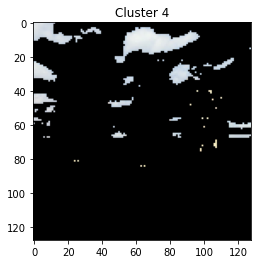

...

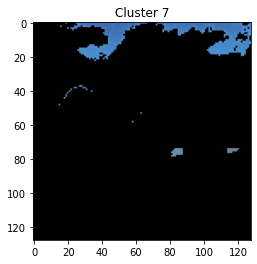

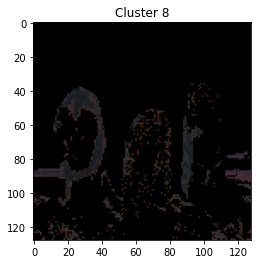

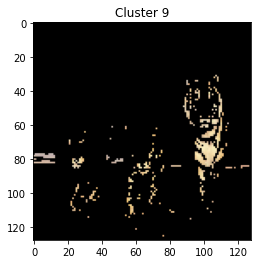

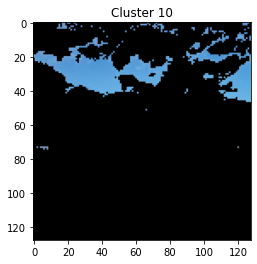

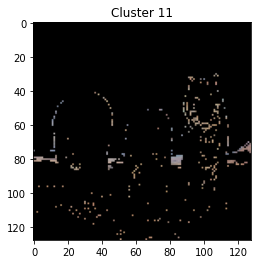


Hi-Beni criteria: 0.017279184891693843


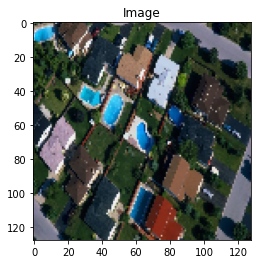

/home/vsydorskyi/anaconda3/envs/venv/lib/python3.7/site-packages/sklearn/cluster/_kmeans.py:974: FutureWarning: 'n_jobs' was deprecated in version 0.23 and will be removed in 0.25.
  " removed in 0.25.", FutureWarning)


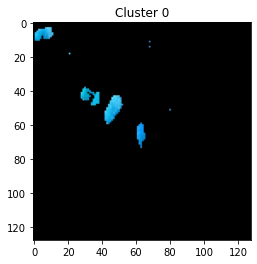

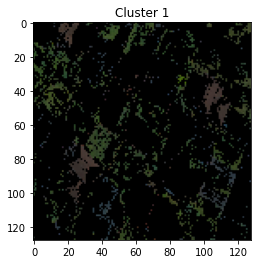

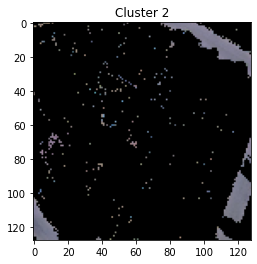

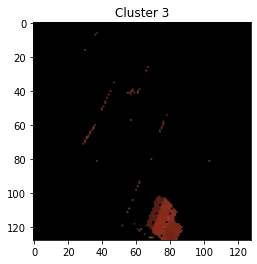

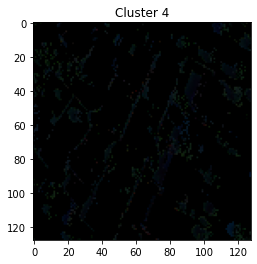

...

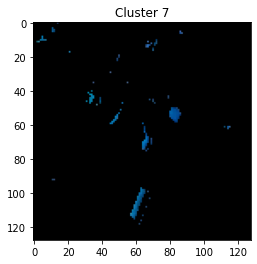

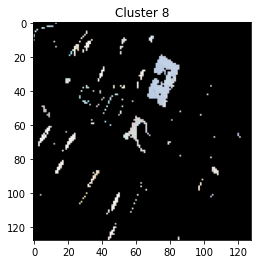

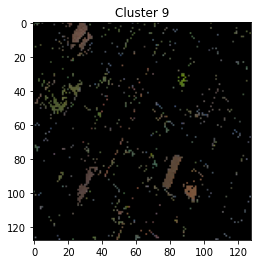

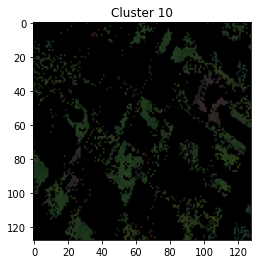

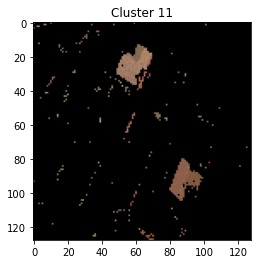


Hi-Beni criteria: 0.025269054414354654


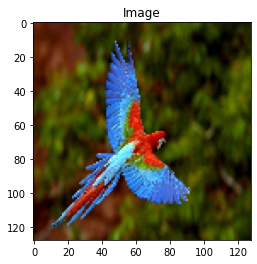

/home/vsydorskyi/anaconda3/envs/venv/lib/python3.7/site-packages/sklearn/cluster/_kmeans.py:974: FutureWarning: 'n_jobs' was deprecated in version 0.23 and will be removed in 0.25.
  " removed in 0.25.", FutureWarning)


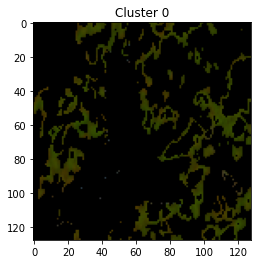

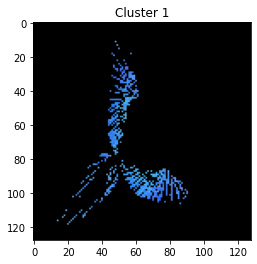

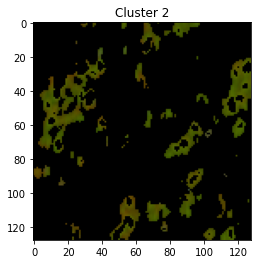

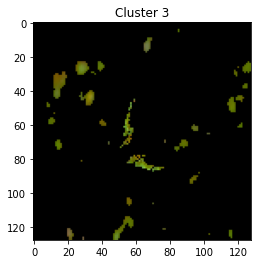

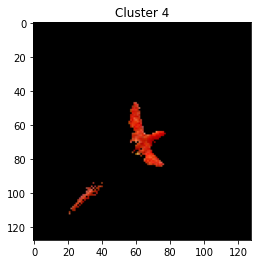

...

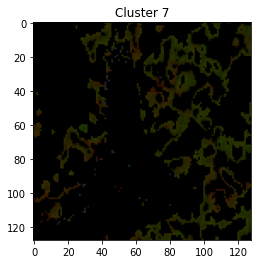

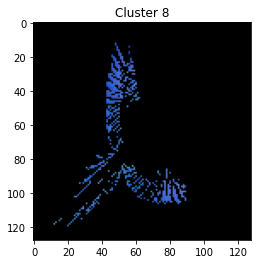

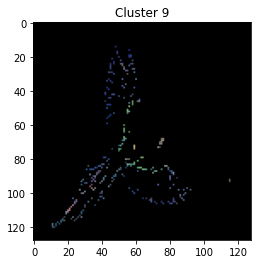

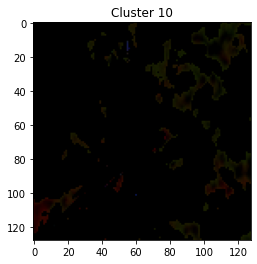

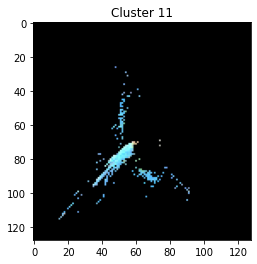


Hi-Beni criteria: 0.026649519661490283


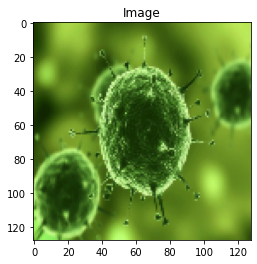

/home/vsydorskyi/anaconda3/envs/venv/lib/python3.7/site-packages/sklearn/cluster/_kmeans.py:974: FutureWarning: 'n_jobs' was deprecated in version 0.23 and will be removed in 0.25.
  " removed in 0.25.", FutureWarning)


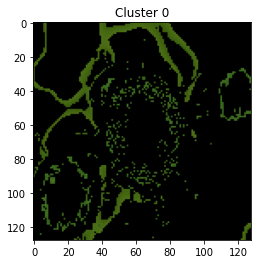

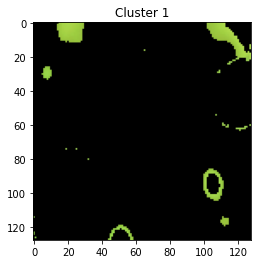

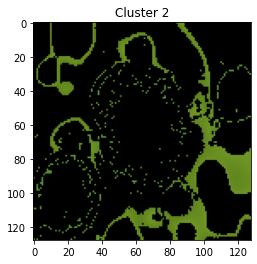

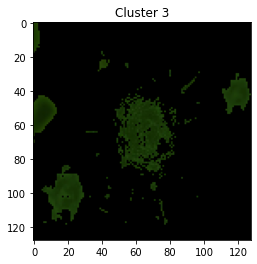

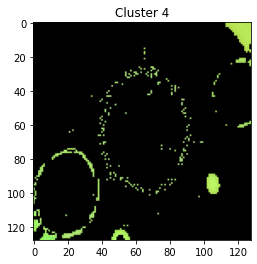

...

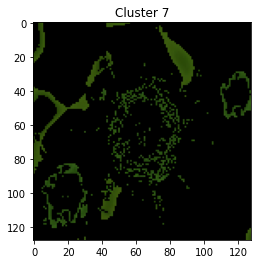

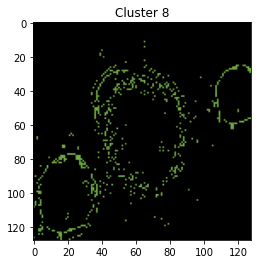

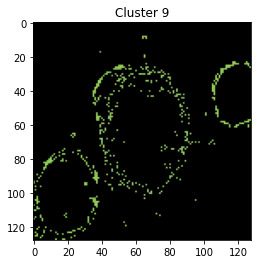

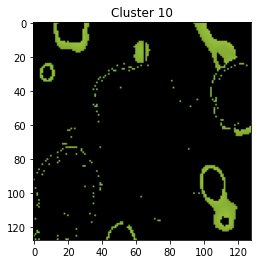

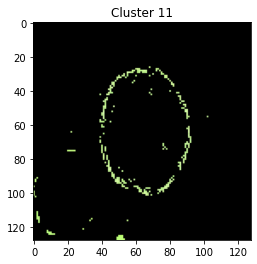


Hi-Beni criteria: 0.018301870627309504



In [5]:
cluster_evaluate_all_images(
    ims=all_images,
    clust_f=lambda x: sklearn_algs(x, KMeans, {"n_clusters":12, "n_jobs":-1}),
    use_coord_enc=False
)

## Sklearn DBSCAN

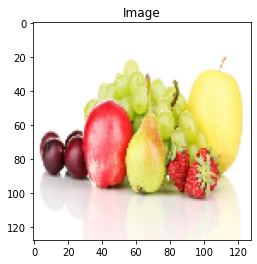

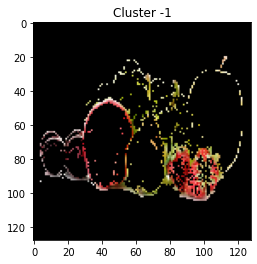

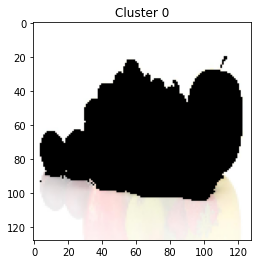

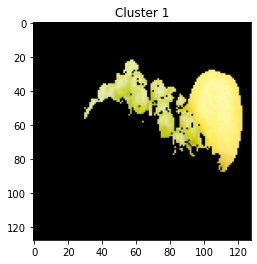

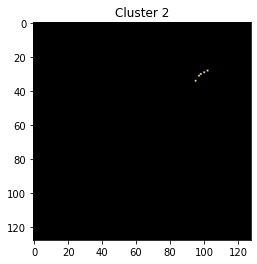

...

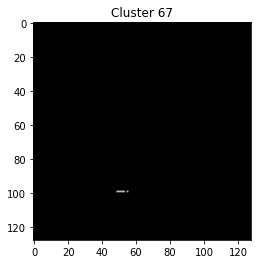

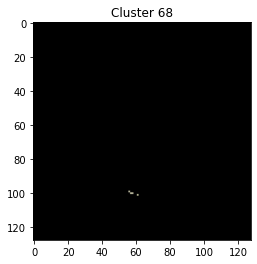

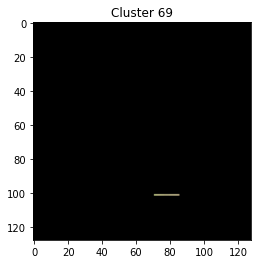

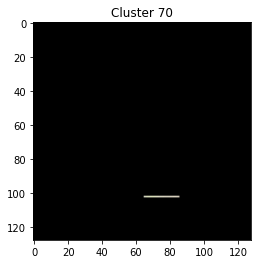

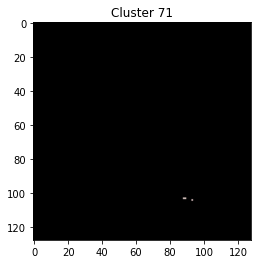


Hi-Beni criteria: 0.09363580968830577


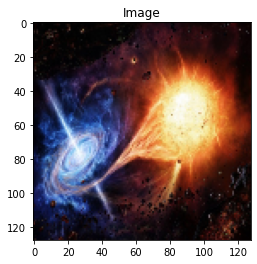

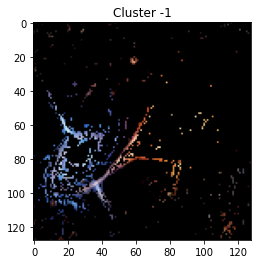

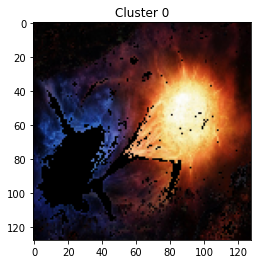

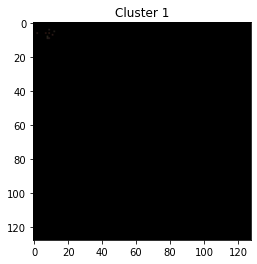

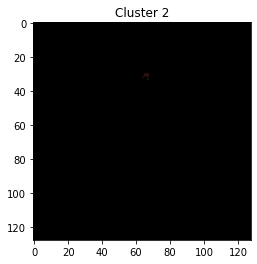

...

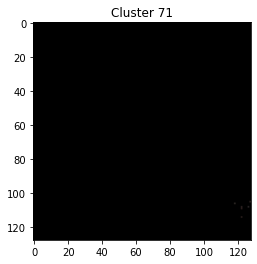

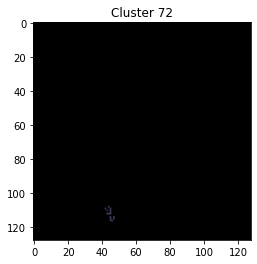

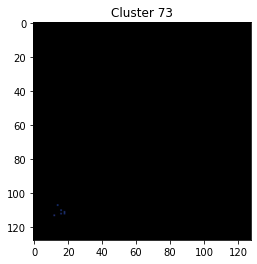

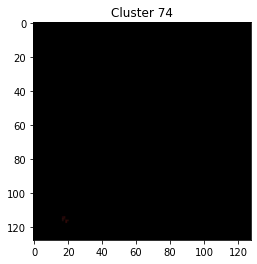

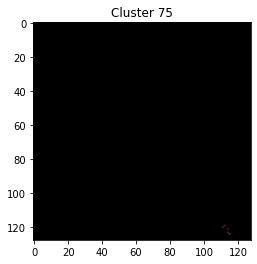


Hi-Beni criteria: 2.067947506520663


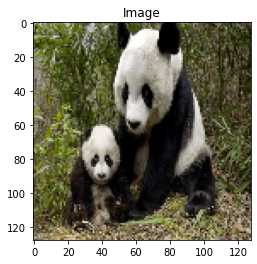

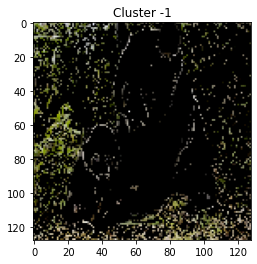

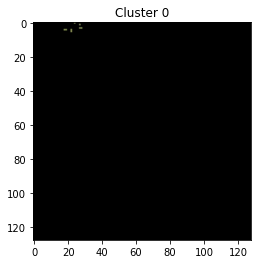

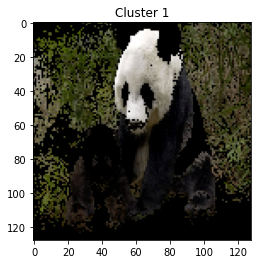

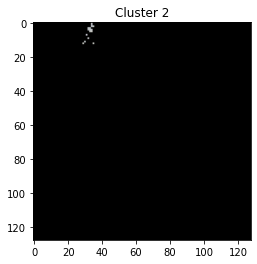

...

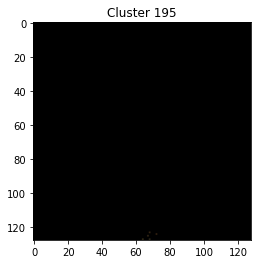

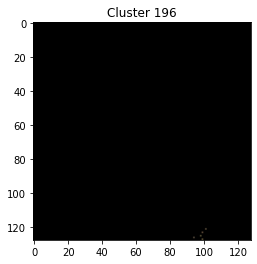

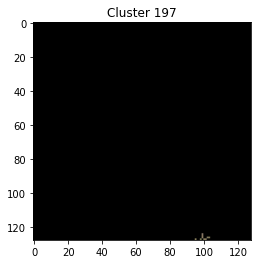

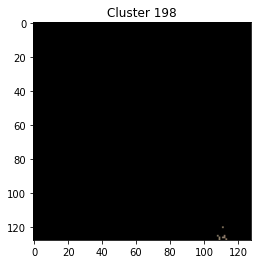

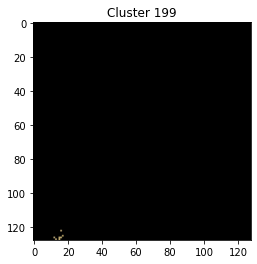


Hi-Beni criteria: 0.558135802472459


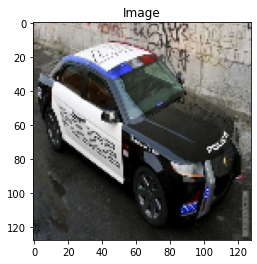

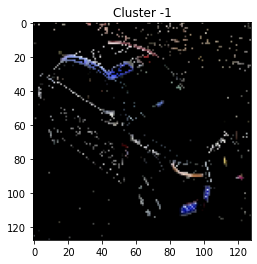

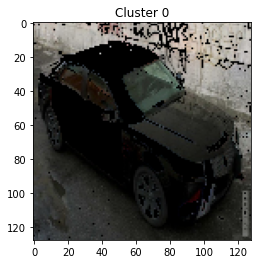

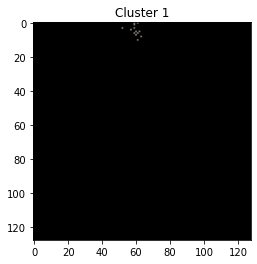

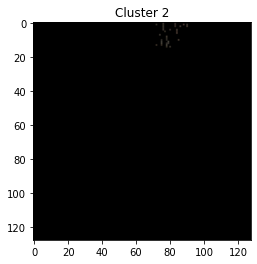

...

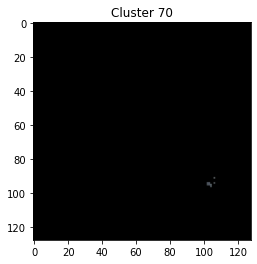

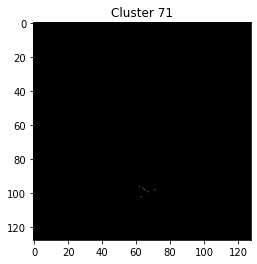

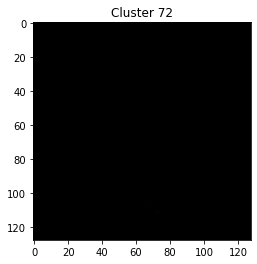

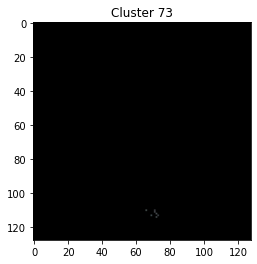

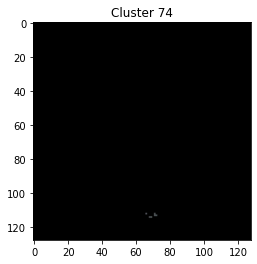


Hi-Beni criteria: 0.9691854733614808


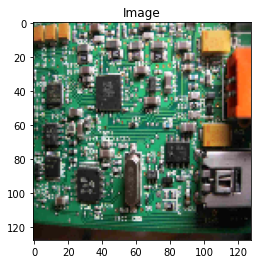

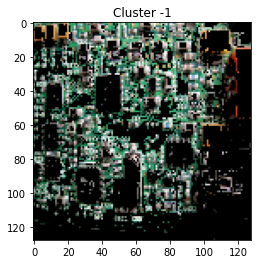

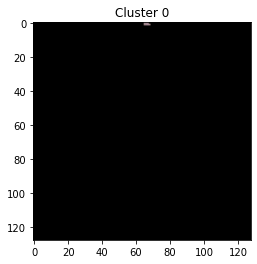

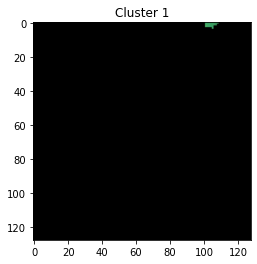

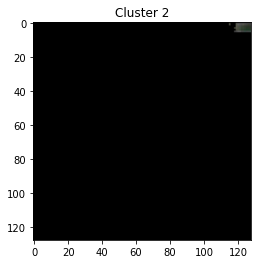

...

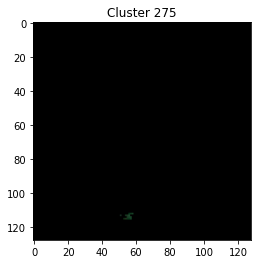

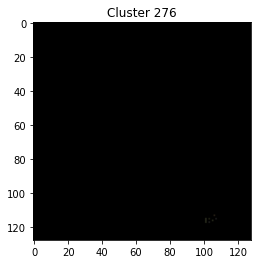

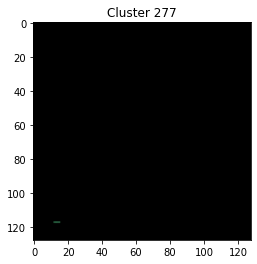

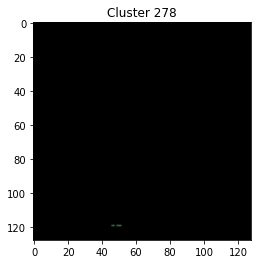

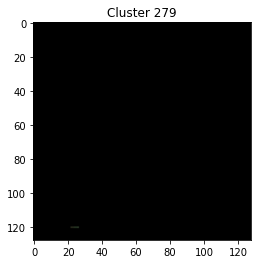


Hi-Beni criteria: 0.27556905935778486


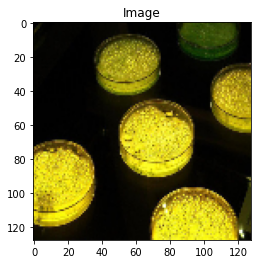

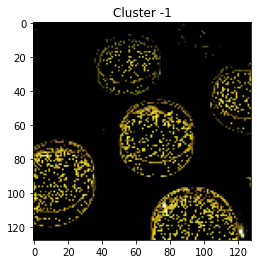

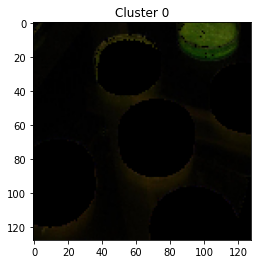

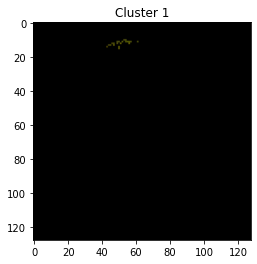

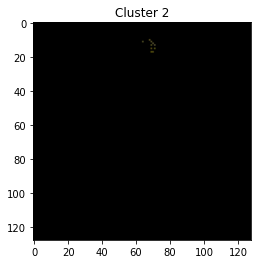

...

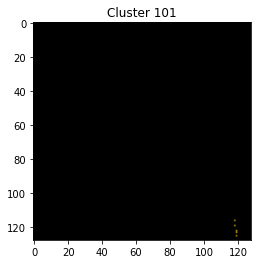

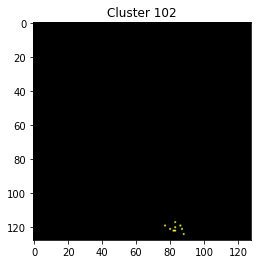

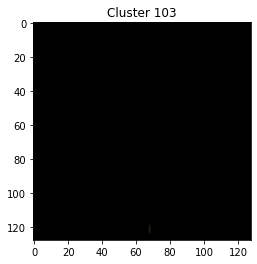

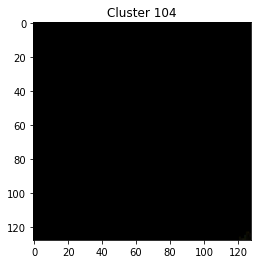

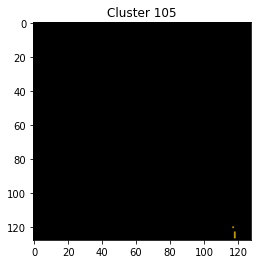


Hi-Beni criteria: 0.06461447871098898


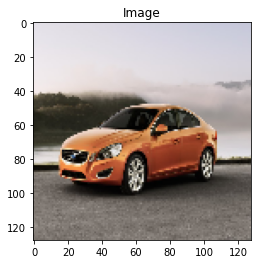

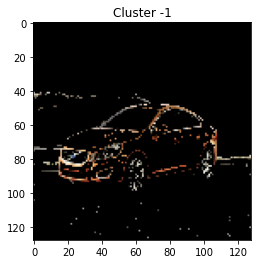

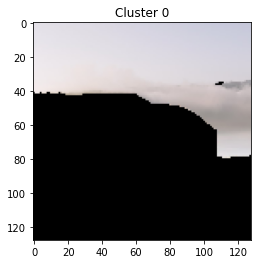

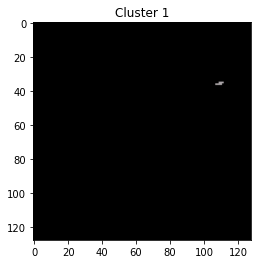

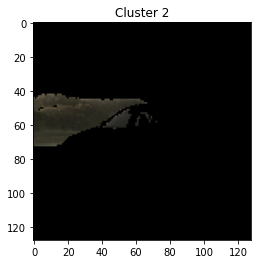

...

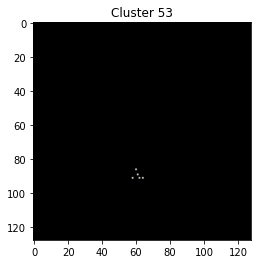

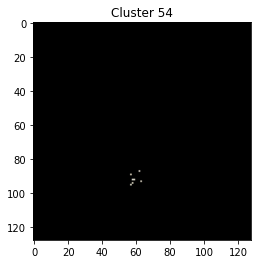

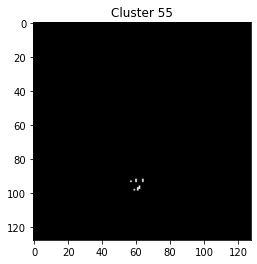

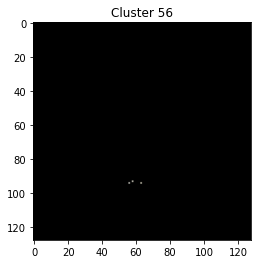

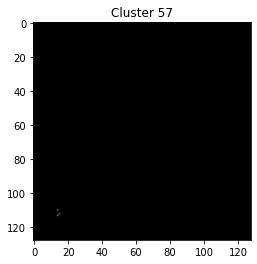


Hi-Beni criteria: 0.10904540964193918


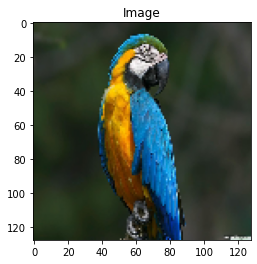

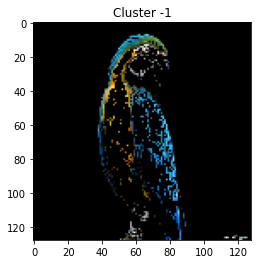

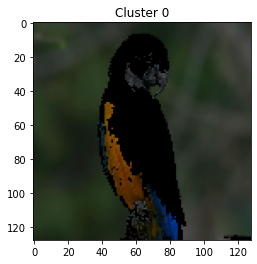

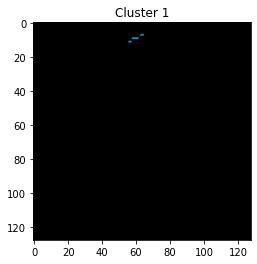

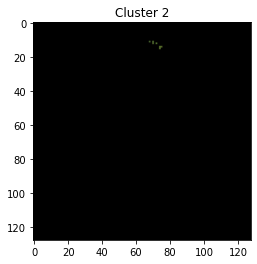

...

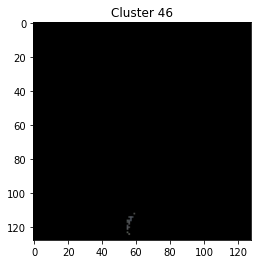

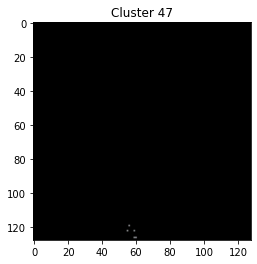

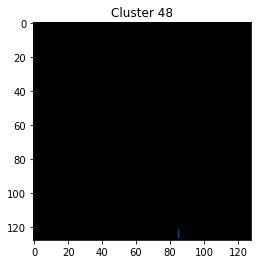

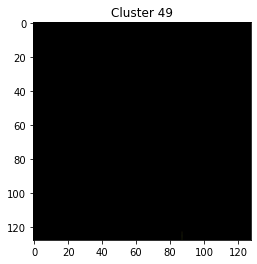

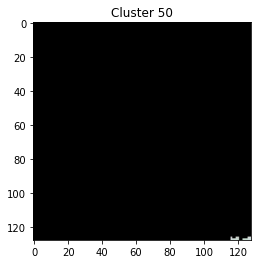


Hi-Beni criteria: 0.3841643738848331


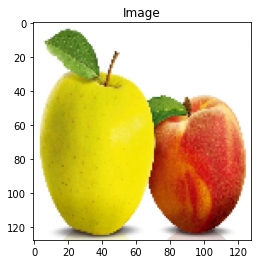

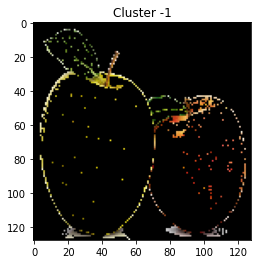

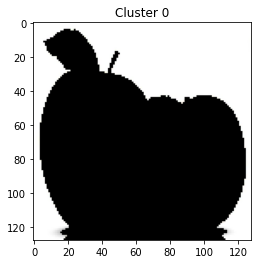

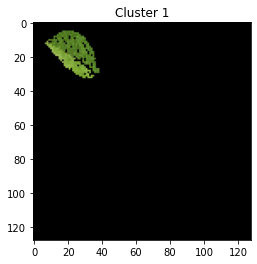

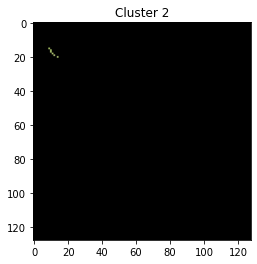

...

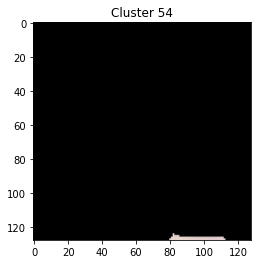

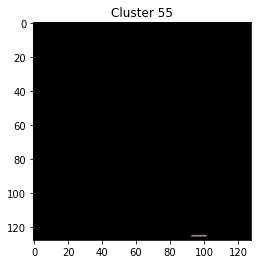

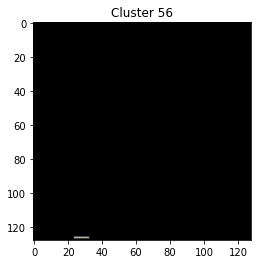

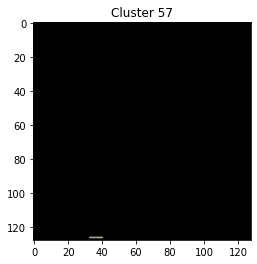

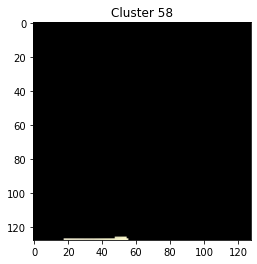


Hi-Beni criteria: 0.0469588315937431


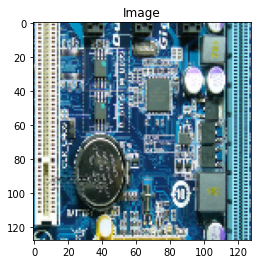

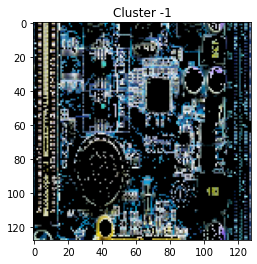

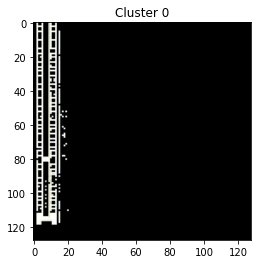

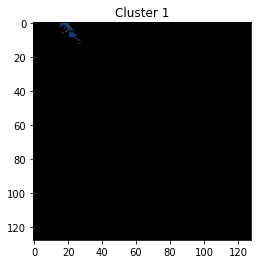

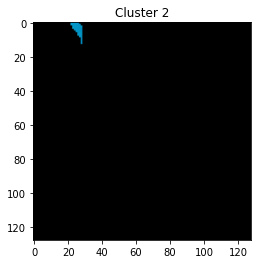

...

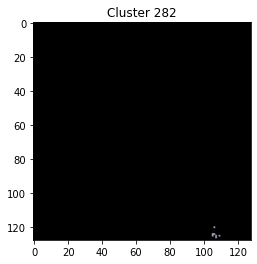

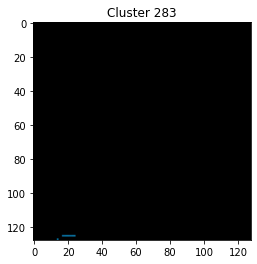

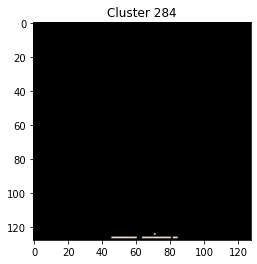

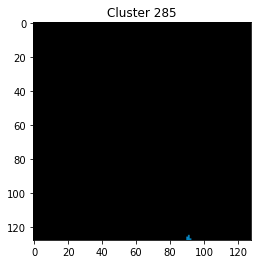

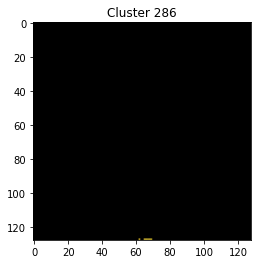


Hi-Beni criteria: 0.18357464611030436


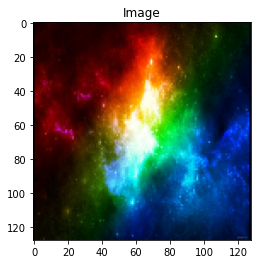

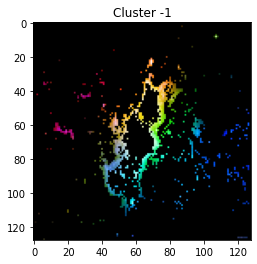

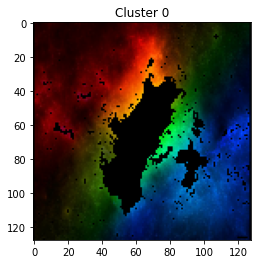

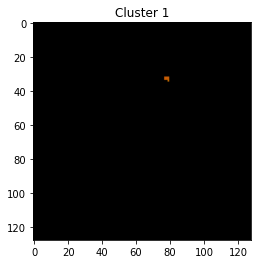

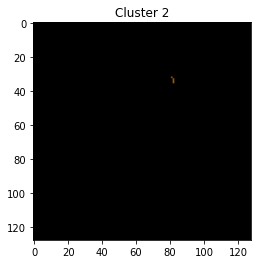

...

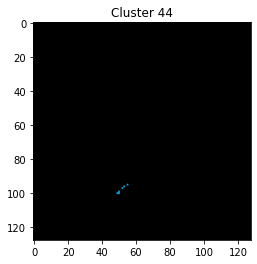

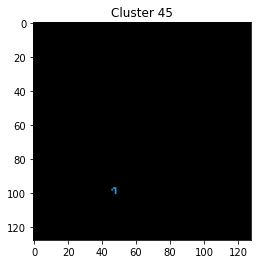

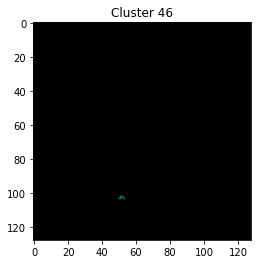

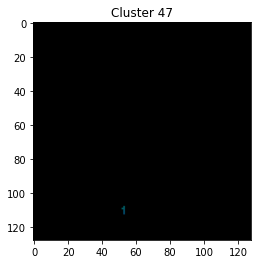

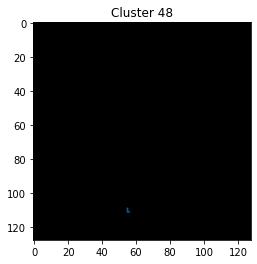


Hi-Beni criteria: 1.170971118122093


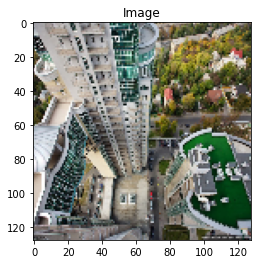

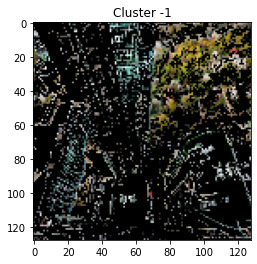

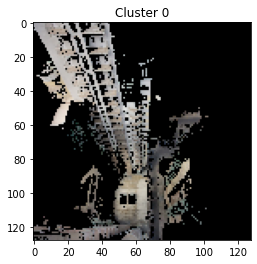

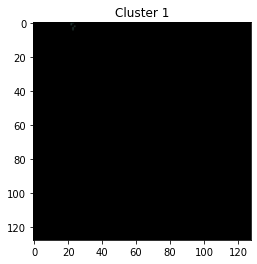

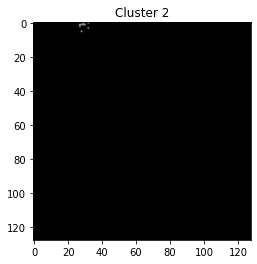

...

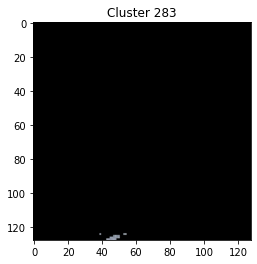

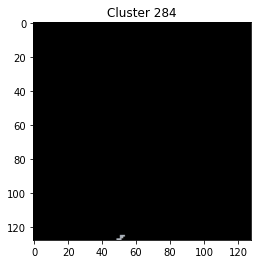

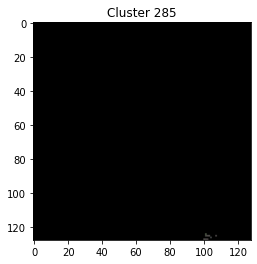

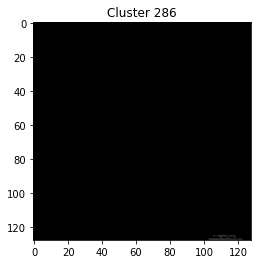

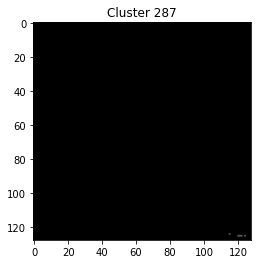


Hi-Beni criteria: 0.16821227245762635


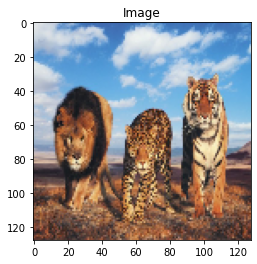

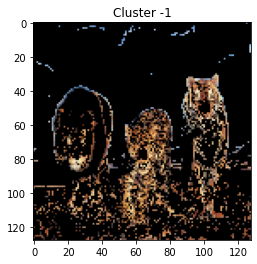

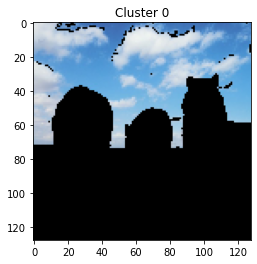

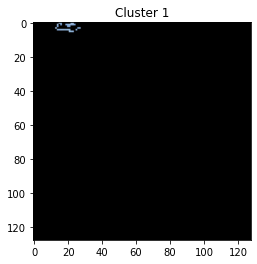

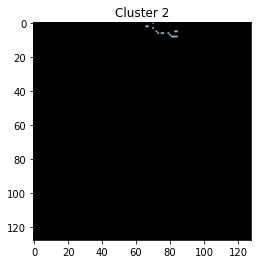

...

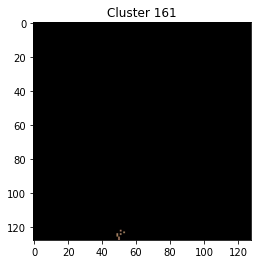

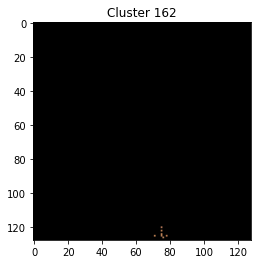

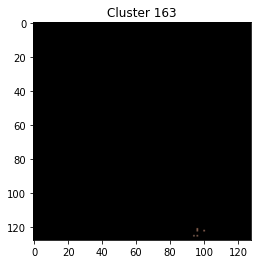

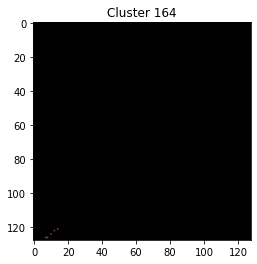

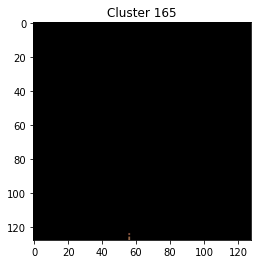


Hi-Beni criteria: 0.15086403282344785


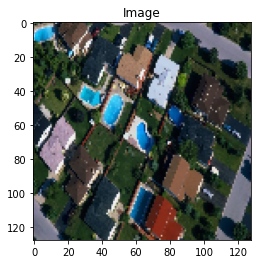

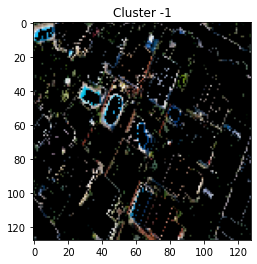

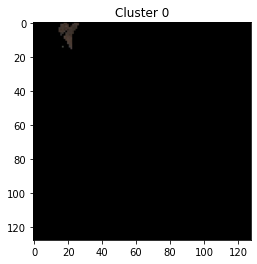

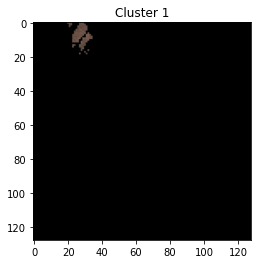

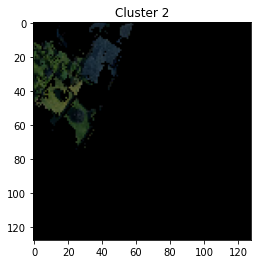

...

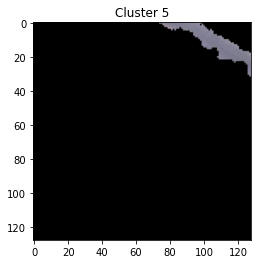

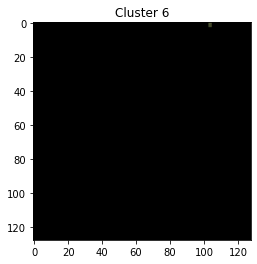

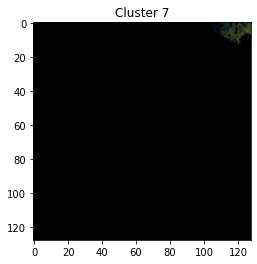

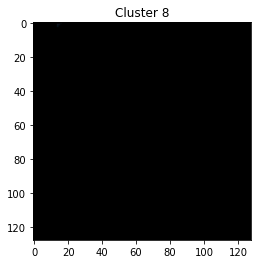

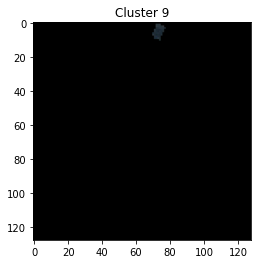


Hi-Beni criteria: 0.09214342726174707


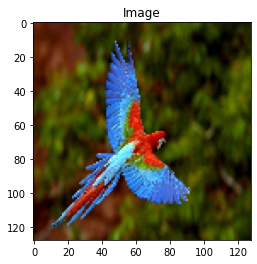


Hi-Beni criteria: 0.5508265427257644


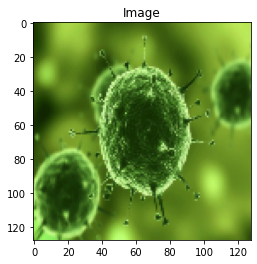


Hi-Beni criteria: 3.1940911613423255



In [6]:
cluster_evaluate_all_images(
    ims=all_images,
    clust_f=lambda x: sklearn_algs(x, DBSCAN, {"eps":0.05,"n_jobs":-1}),
    use_coord_enc=True
)

## Sklearn Spectral clustering

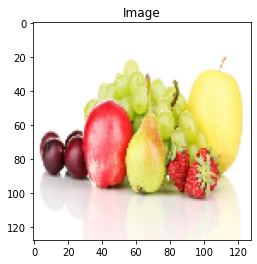


Hi-Beni criteria: 0.027509764433391284


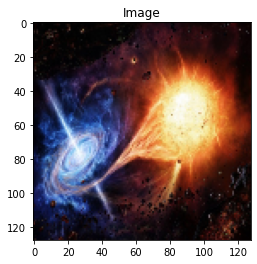


Hi-Beni criteria: 0.037761799189278314


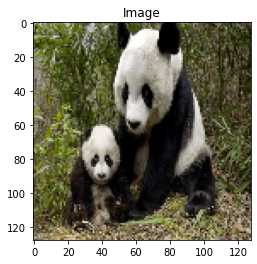


Hi-Beni criteria: 0.03799670979588753


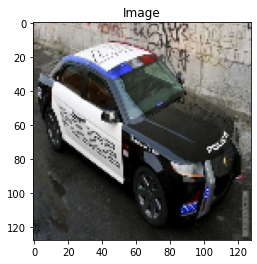


Hi-Beni criteria: 0.03827128078685222


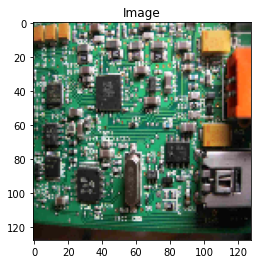


Hi-Beni criteria: 0.04353540519105724


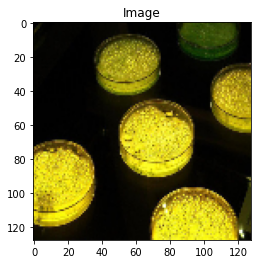


Hi-Beni criteria: 0.017108445838253453


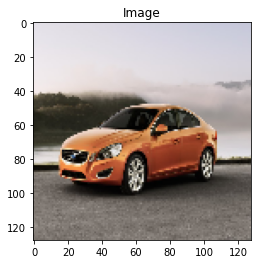


Hi-Beni criteria: 0.020609958139014038


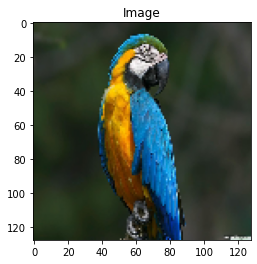


Hi-Beni criteria: 0.0749868257685058


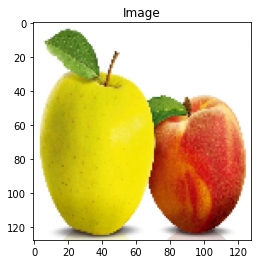


Hi-Beni criteria: 0.011689755404978656


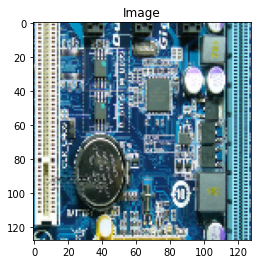


Hi-Beni criteria: 0.035402278288998744


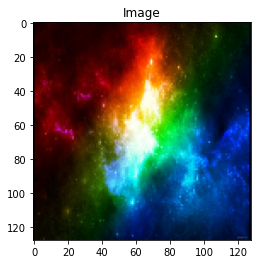


Hi-Beni criteria: 0.09721347309721315


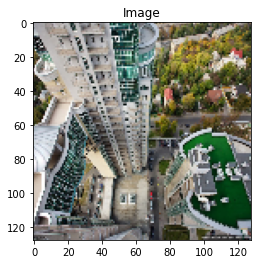


Hi-Beni criteria: 0.0483041889598353


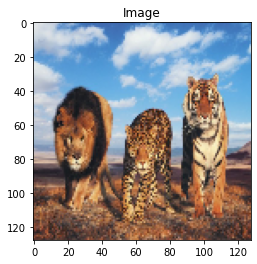


Hi-Beni criteria: 0.02715708581068337


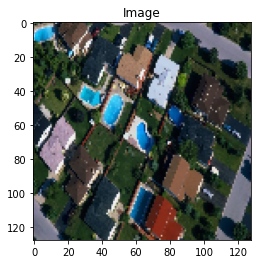


Hi-Beni criteria: 0.06170093060349726


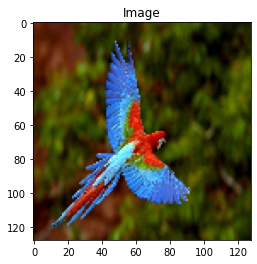


Hi-Beni criteria: 0.08336826681236684


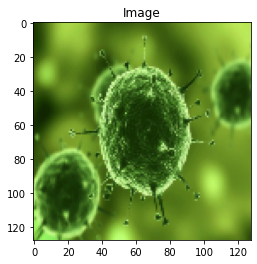


Hi-Beni criteria: 0.03444648353524421



In [8]:
cluster_evaluate_all_images(
    ims=all_images,
    clust_f=lambda x: sklearn_algs(x, SpectralClustering, {"n_clusters":12, "n_jobs":-1}),
    use_coord_enc=False
)

## CV2 KMeans

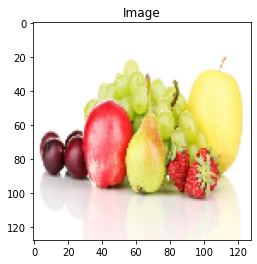


Hi-Beni criteria: 0.014204114499495275


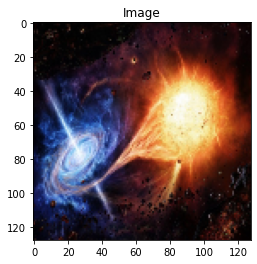


Hi-Beni criteria: 0.020393642571649


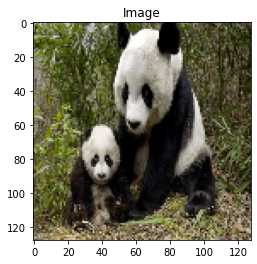


Hi-Beni criteria: 0.01777195681641108


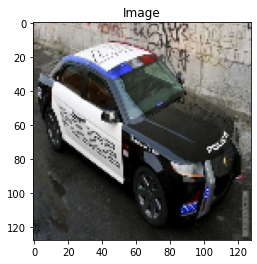


Hi-Beni criteria: 0.013305038228982654


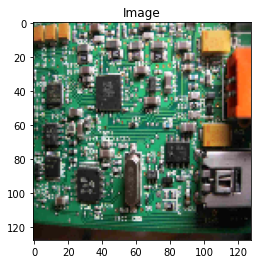


Hi-Beni criteria: 0.023092247612798943


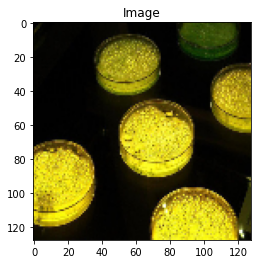


Hi-Beni criteria: 0.010974141611025256


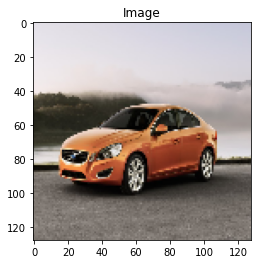


Hi-Beni criteria: 0.013974324159372643


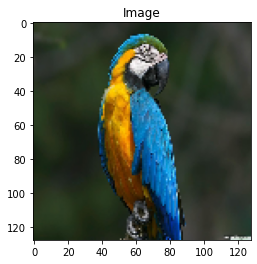


Hi-Beni criteria: 0.04860865526635704


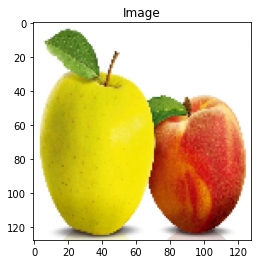


Hi-Beni criteria: 0.01179693469522879


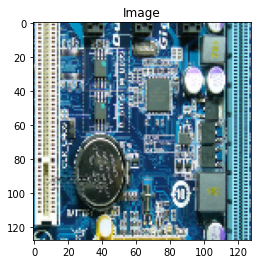


Hi-Beni criteria: 0.022011856778161046


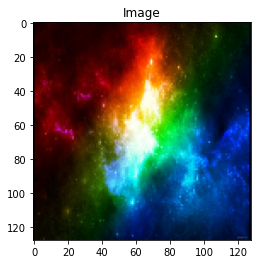


Hi-Beni criteria: 0.0358571102658356


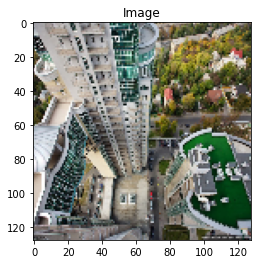


Hi-Beni criteria: 0.02155960340520958


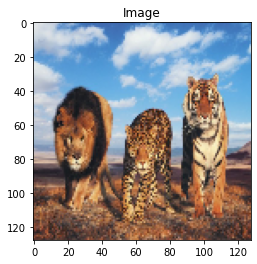


Hi-Beni criteria: 0.018006445969145905


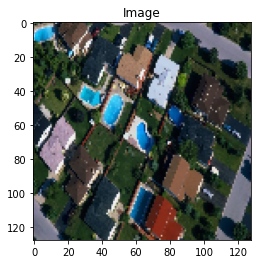


Hi-Beni criteria: 0.028713246687749047


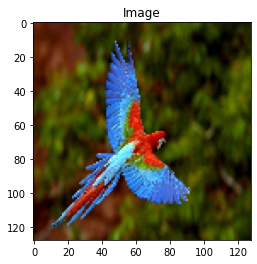


Hi-Beni criteria: 0.033329239930761485


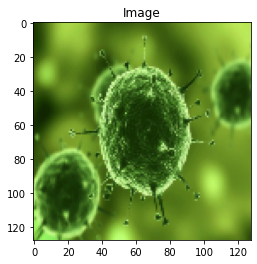


Hi-Beni criteria: 0.01952460727846182



In [9]:
cluster_evaluate_all_images(
    ims=all_images,
    clust_f=lambda x: cv2_kmeans(x, {
        "max_iter":10_000, 
        'epsilon':0.0001,
        'n_clusters':12,
        'n_attempts':2,
    })
)

## Fuzzy KMeans

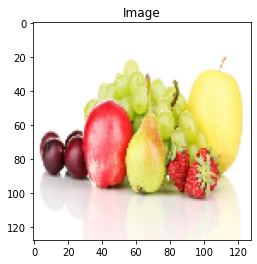


Hi-Beni criteria: 1.2838390786882832


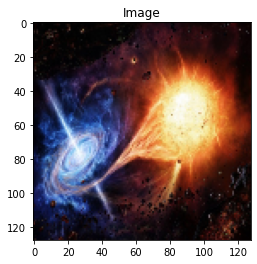


Hi-Beni criteria: 0.2362860515584403


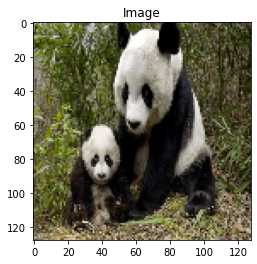


Hi-Beni criteria: 0.8105179537872079


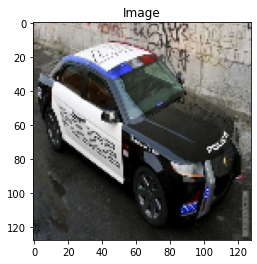


Hi-Beni criteria: 0.3203662575521733


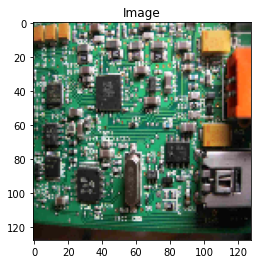


Hi-Beni criteria: 0.291232268938019


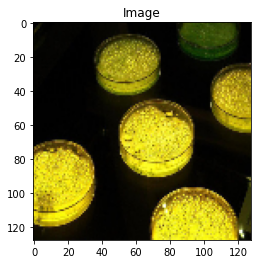


Hi-Beni criteria: 0.19570413885898294


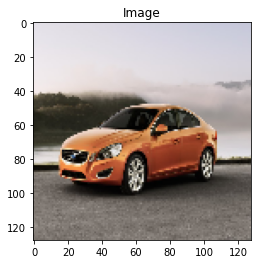


Hi-Beni criteria: 0.33567335554409233


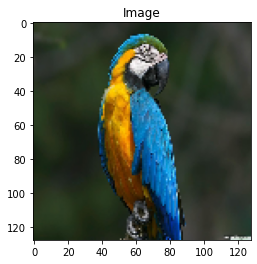


Hi-Beni criteria: 0.5939865938062784


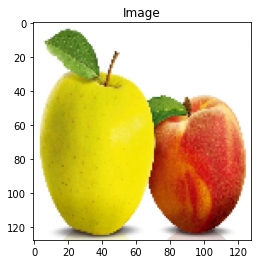


Hi-Beni criteria: 0.31296599373058837


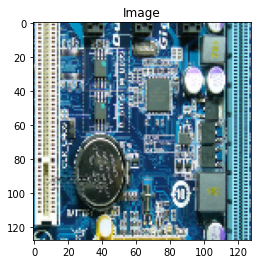


Hi-Beni criteria: 0.4457547281474646


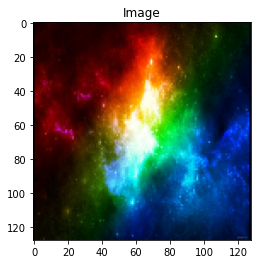


Hi-Beni criteria: 0.682629127716186


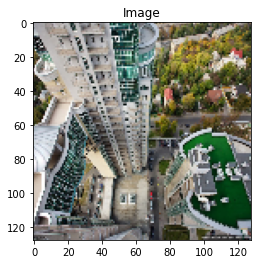


Hi-Beni criteria: 0.40361854690755267


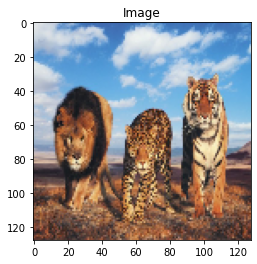


Hi-Beni criteria: 0.18832697019883995


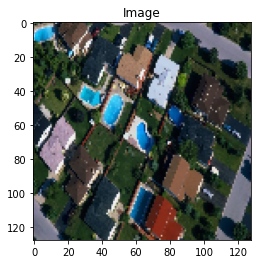


Hi-Beni criteria: 0.7595805946268545


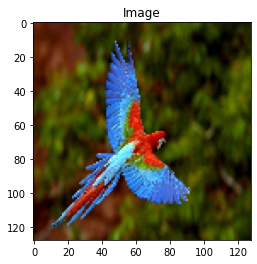


Hi-Beni criteria: 1.150971518060815


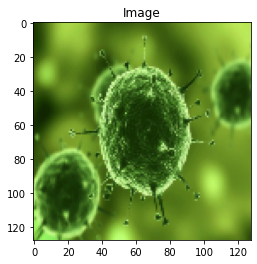


Hi-Beni criteria: 0.4455582803722144



In [12]:
cluster_evaluate_all_images(
    ims=all_images,
    clust_f=lambda x: fuzzy_kmeans(x, {
        "return_classes":True, 
        'c':12,
        'm':0.99,
        'error':0.01,
        'maxiter':10_000
    })
)